In [211]:
import numpy as np
import random
from datetime import datetime
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from scipy.stats import norm

In [212]:
class Agent:
    """Defines an individual agent with life expectancy and resource consumption."""
    def __init__(self, id, consumption_range_min, consumption_range_max, intelligence_distribution, resource_net_zero):
        self.life_expectancy = random.randint(2, 5)  # Add variability in life expectancy
        self.age = 0
        self.alive = True
        self.resource_consumption = random.uniform(consumption_range_min, consumption_range_max)  # Variable consumption
        self.id = id
        self.scarcity_birth_factor = 0
        self.intelligence = intelligence_distribution.rvs()
        self.resource_net_zero = resource_net_zero

        # Intelligence-based resource impact
        self.intelligence_probability_inverse = 1 - intelligence_distribution.pdf(self.intelligence)
        population_average_consumption = (consumption_range_min + consumption_range_max) / 2
        self.intelligence_resource_impact = (
            self.intelligence_probability_inverse**2
        ) * (10 * population_average_consumption)

    def does_agent_reproduce(self):
        """Determine if the agent reproduces based on scarcity and a random chance."""
        chance = random.random()
        comparitor = max(0.1, 0.8 - self.scarcity_birth_factor)  # Ensure comparitor doesn't go negative
        return chance < comparitor

    def health_check(self, current_resources, current_population, resource_replenishment_rate):
        """Check if agent is alive and update scarcity factor."""
        self.age += 1
        self.alive = self.age < self.life_expectancy

        # Calculate scarcity
        carrying_capacity = resource_replenishment_rate / self.resource_consumption
        scarcity = current_population - carrying_capacity
        self.scarcity_birth_factor = max(0, (scarcity / carrying_capacity) ** 2)

    def consume_resources(self):
        """Determine resource consumption based on intelligence."""
        if not self.alive:
            return 0

        # Adjust resource consumption dynamically
        if self.intelligence > self.resource_net_zero:
            # Intelligent agents can create resources
            return -self.intelligence_resource_impact
        else:
            # Less intelligent agents consume more resources
            return self.resource_consumption + (self.resource_net_zero - self.intelligence)


In [213]:
class Simulation:
    """Encapsulates the agent-based simulation."""
    def __init__(self, generations, initial_resources, resource_replenishment_rate, agent_creation_count,
                 consumption_range_min, consumption_range_max, intelligence_mean=100, intelligence_std_dev=10):
        self.generations = generations
        self.initial_resources = initial_resources
        self.resource_replenishment_rate = resource_replenishment_rate
        self.agent_creation_count = agent_creation_count
        self.resources = [initial_resources]
        self.population = []
        self.intelligence_levels = []  # Track intelligence levels
        self.consumption_range_min = consumption_range_min
        self.consumption_range_max = consumption_range_max
        self.intelligence_distribution = norm(loc=intelligence_mean, scale=intelligence_std_dev)
        self.agents = [Agent(id, self.consumption_range_min, self.consumption_range_max, self.intelligence_distribution, 100) for id in range(agent_creation_count)]
        
    def run(self):
        """Run the simulation for the specified number of generations."""
        for t in range(self.generations):
            current_resources = self.resources[-1] + self.resource_replenishment_rate
            alive_agents = [agent for agent in self.agents if agent.alive]

            # Track intelligence levels
            self.intelligence_levels.append([agent.intelligence for agent in alive_agents])

            # Agents consume resources
            total_consumption = sum(agent.consume_resources() for agent in alive_agents)
            current_resources -= total_consumption
            current_resources = max(current_resources, 0)  # Resources cannot go negative
            self.resources.append(current_resources)

            # Update agents
            new_agents = []
            for agent in alive_agents:
                agent.health_check(current_resources, len(alive_agents), self.resource_replenishment_rate)
                if agent.does_agent_reproduce():
                    self.agent_creation_count += 1
                    new_agents.append(
                        Agent(
                            self.agent_creation_count,
                            self.consumption_range_min,
                            self.consumption_range_max,
                            self.intelligence_distribution,
                            100
                        )
                    )
                new_agents.append(agent)
            self.agents = new_agents
            self.population.append(len(alive_agents))

        # Return the Simulation object itself for easier reference
        return self


In [215]:
def rank_and_summarize(simulations):
    """Rank simulations by longevity and summarize key metrics."""
    # Create a DataFrame for easier analysis
    summary_data = [
        {
            "Simulation": i + 1,
            "Consumption Min": sim.consumption_range_min,
            "Consumption Max": sim.consumption_range_max,
            "Resource Replenishment Rate": sim.resource_replenishment_rate,
            "Longevity": len([p for p in sim.population if p > 0]),
            "Max Population": max(sim.population) if sim.population else 0,
            "Avg Population": np.mean(sim.population) if sim.population else 0,
            "Total Resources": sum(sim.resources) if sim.resources else 0
        }
        for i, sim in enumerate(simulations)
    ]
    df_summary = pd.DataFrame(summary_data)

    # Rank by longevity
    df_summary = df_summary.sort_values(by="Longevity", ascending=False).reset_index(drop=True)

    # Save to file with a timestamp in the name
    timestamp = datetime.now().strftime('%Y%m%d%H%M%S')
    df_summary.to_csv(f"data/simulation_results_{timestamp}.csv", index=False)

    return df_summary


In [237]:
# Run multiple simulations
num_simulations = 1000
simulation_results = []

for _ in range(num_simulations):
    consumption_range_min = random.uniform(0.05, 0.5)
    consumption_range_max = random.uniform(consumption_range_min, 2)
    simulation = Simulation(
        generations=500,
        initial_resources=1000,
        resource_replenishment_rate=random.randint(10, 30),
        agent_creation_count=4,
        consumption_range_min=consumption_range_min,
        consumption_range_max=consumption_range_max
    )
    simulation_results.append(simulation.run())  # Store the Simulation object





In [238]:
# Rank and summarize results
simulation_summary = rank_and_summarize(simulation_results)

In [239]:
import plotly.graph_objects as go

def plot_multiple_simulations_plotly(simulations):
    """
    Plot the results of multiple simulations using Plotly.
    
    Args:
        simulations (list): List of Simulation objects.
    """
    # Sort simulations by longevity
    simulations.sort(key=lambda sim: len([p for p in sim.population if p > 0]), reverse=True)
    
    # Select the top simulations (adjust as needed)
    top_simulations = simulations[:100000]  # Change the number to include more or fewer top simulations

    # Create population dynamics plot
    population_fig = go.Figure()
    for i, sim in enumerate(top_simulations):
        label = f"Sim {i+1}: Range=({sim.consumption_range_min:.2f}, {sim.consumption_range_max:.2f}), RR={sim.resource_replenishment_rate}"
        population_fig.add_trace(go.Scatter(
            x=list(range(len(sim.population))),
            y=sim.population,
            mode='lines',
            name=label
        ))
    population_fig.update_layout(
        title="Population Dynamics Across Simulations",
        xaxis_title="Generations",
        yaxis_title="Population",
        legend_title="Simulations",
        template="plotly_white"
    )

    # Create resource dynamics plot
    resource_fig = go.Figure()
    for i, sim in enumerate(top_simulations):
        label = f"Sim {i+1}: Range=({sim.consumption_range_min:.2f}, {sim.consumption_range_max:.2f}), RR={sim.resource_replenishment_rate}"
        resource_fig.add_trace(go.Scatter(
            x=list(range(len(sim.resources))),
            y=sim.resources,
            mode='lines',
            name=label
        ))
    resource_fig.update_layout(
        title="Resource Levels Across Simulations",
        xaxis_title="Generations",
        yaxis_title="Resources",
        legend_title="Simulations",
        template="plotly_white"
    )

    # Display plots
    population_fig.show()
    resource_fig.show()


In [240]:
# Plot the top simulations using the updated function
plot_multiple_simulations_plotly(simulation_results)


In [241]:
print(type(simulation_results[0]))  # Should print <class '__main__.Simulation'>


<class '__main__.Simulation'>


In [242]:
print(simulation_summary.head())


   Simulation  Consumption Min  Consumption Max  Resource Replenishment Rate  \
0         847         0.316923         1.532736                           10   
1         809         0.437919         1.794796                           14   
2         176         0.115615         1.427443                           10   
3         833         0.228931         1.888674                           15   
4         832         0.093638         1.788297                           12   

   Longevity  Max Population  Avg Population  Total Resources  
0        500              36          23.574     2.142207e+06  
1        500              41          27.130     4.804901e+06  
2        500              51          30.940     2.766208e+05  
3        500              54          32.718     4.702618e+06  
4        500              55          29.440     1.360989e+06  


846


/home/biff/.pyenv/versions/3.9.12/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning:

Mean of empty slice.

/home/biff/.pyenv/versions/3.9.12/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning:

invalid value encountered in scalar divide



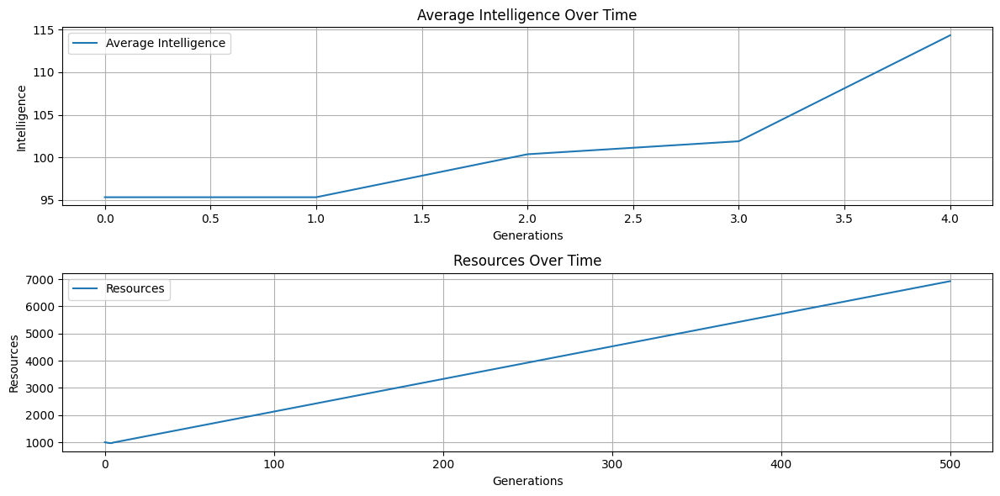

In [243]:
# Ensure the top simulation is correctly matched with the Simulation object
top_simulation_index = int(simulation_summary.iloc[0]["Simulation"] - 1)  # Adjust for zero-based indexing
print(top_simulation_index)
top_simulation_instance = simulation_results[top_simulation_index]

# Check if the instance is valid and plot
if isinstance(top_simulation_instance, Simulation):
    plot_intelligence_and_resources(top_simulation_instance)
else:
    print("Error: Expected a Simulation object but received a different structure.")
